<a href="https://colab.research.google.com/github/piyush-kgp/VAE-PyTorch/blob/master/pytorch_vae.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!rm -rf *

In [0]:
import torch
from torch.autograd import Variable
import numpy as np
import torch.nn.functional as F
import torchvision
from torchvision import transforms
import torch.optim as optim
from torch import nn
import matplotlib.pyplot as plt
from torchvision.datasets import MNIST
import torch
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from torchvision.utils import save_image
import numpy as np
import os

In [0]:
class Encoder(nn.Module):
  def __init__(self, latent_dim):
    super().__init__()
    self.fc1 = nn.Linear(784, 512)
    self.fc2 = nn.Linear(512, 128)
    self.fc3 = nn.Linear(128, latent_dim)
    self.fc4 = nn.Linear(128, latent_dim)
  def forward(self, x):
    x = self.fc1(x)
    x = self.fc2(x)
    y = self.fc3(x)
    z = self.fc4(x)
    return y, z

class Decoder(nn.Module):
  def __init__(self, latent_dim):
    super().__init__()
    self.fc1 = nn.Linear(latent_dim, 128)
    self.fc2 = nn.Linear(128, 512)
    self.fc3 = nn.Linear(512, 784)
  def forward(self, x):
    x = self.fc1(x)
    x = self.fc2(x)
    x = self.fc3(x)
    return x

class VAE(nn.Module):
  def __init__(self, latent_dim):
    super().__init__()
    self.latent_dim = latent_dim
    self.encoder = Encoder(latent_dim)
    self.decoder = Decoder(latent_dim)
  def forward(self, x):
    mu, logvar = self.encoder(x)
    std = torch.exp(0.5*logvar)
    eps = torch.randn_like(std)
    z = mu + eps*std
    out = self.decoder(z)
    return out, mu, logvar


def loss_function(recon_x, x, mu, logvar):
    MSE = nn.MSELoss(reduction='sum')(recon_x, x)
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return MSE + KLD



In [0]:
def train(epoch, model, optimizer, train_loader, device, writer):
    model.train()
    train_loss = 0
    num_batches = len(train_loader)
    for batch_idx, (data, _) in enumerate(train_loader):
        data = data.to(device).view(-1,784)
        optimizer.zero_grad()
        recon_batch, mu, logvar = model(data)

        loss = loss_function(recon_batch, data, mu, logvar)
        loss.backward()
        optimizer.step()

        train_loss += loss.item()
        print('[Train] Epoch: {} {}/{} Loss {}'.format(epoch, batch_idx, num_batches, loss.item()/len(data)))
        writer.add_scalar("Batch_Loss/Train", loss.item()/len(data), epoch*num_batches+batch_idx)

    print('Epoch: {} Average Train loss: {}'.format(epoch, train_loss/len(train_loader.dataset)))
    # writer.add_scalar("Epoch_Loss/Train", train_loss/len(train_loader.dataset), epoch)

    return train_loss/len(train_loader.dataset)


In [0]:
def test(epoch, model, test_loader, device, writer):
    model.eval()
    test_loss = 0
    num_batches = len(test_loader)

    latent_points, labels = [], []
    with torch.no_grad():
        for batch_idx, (data, y) in enumerate(test_loader):
            data = data.to(device).view(-1,784)
            recon_batch, mu, logvar = model(data)

            latent_points.append(mu.tolist())
            labels.append(y.tolist())

            loss = loss_function(recon_batch, data, mu, logvar)

            test_loss += loss.item()
            print('[Test] Epoch: {} {}/{} Loss {}'.format(epoch, batch_idx, num_batches, loss.item()/len(data)))
            writer.add_scalar("Batch_Loss/Test", loss.item()/len(data), epoch*num_batches+batch_idx)

            grid = torchvision.utils.make_grid(data)
            writer.add_image('Original', grid, epoch*num_batches+batch_idx)
            grid = torchvision.utils.make_grid(recon_batch)
            writer.add_image('Reconstructed', grid, epoch*num_batches+batch_idx)
            

    print('Epoch: {} Average Test loss: {}'.format(epoch, test_loss/len(test_loader.dataset)))
    # writer.add_scalar("Epoch_Loss/Test", test_loss/len(test_loader.dataset), epoch)
 
    # for the last batch save 8 images per epoch
    to_save_img = torch.cat([data[:8], recon_batch[:8]]).view(-1, 1, 28, 28)
    save_image(to_save_img.cpu(), 'results/reconstruction_{}.png'.format(epoch), nrow=8)

    latent_point_all = np.concatenate(latent_points)
    label_all = np.concatenate(labels)

    return test_loss/len(test_loader.dataset), latent_point_all, label_all

 

In [0]:
def main():
  os.makedirs("results", exist_ok=True)
  print(torch.cuda.is_available())
  num_epochs = 50
  init_lr = 1e-3

  train_dataset = MNIST(root='mnist/', train=True, transform=transforms.Compose([transforms.ToTensor()]), download=True)
  test_dataset = MNIST(root='mnist/', train=False, transform=transforms.Compose([transforms.ToTensor()]), download=True)

  train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
  test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)


  device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
  vae = VAE(2)
  print(vae)

  optimizer = optim.Adam(vae.parameters(), lr=init_lr)
  vae = nn.DataParallel(vae).to(device)

  writer = SummaryWriter(log_dir='logs/')

  for epoch in range(num_epochs):
    lr = init_lr*(1 - epoch/num_epochs)**0.9
    for param_group in optimizer.param_groups:
      param_group['lr'] = lr
    print("Epoch {} LR {}".format(epoch, lr))
    writer.add_scalar("Epoch_vs_LR", lr, epoch)

    train_loss = train(epoch, vae, optimizer, train_loader, device, writer)
    test_loss, latent_points, labels = test(epoch, vae, test_loader, device, writer)
    writer.add_scalars("Epoch_Loss", {"train": train_loss, "test": test_loss}, epoch)
    
    fig = plt.figure(figsize=(10,8))
    ax = plt.gca()
    scatter = ax.scatter(latent_points[:,0], latent_points[:,1], s=20, c=labels)
    legend1 = ax.legend(*scatter.legend_elements(), loc="lower left", title="Classes")
    ax.grid(True)
    fig.savefig("latent_distribution_epoch_{}.jpg".format(epoch))


In [0]:
%load_ext tensorboard


In [8]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 202), started 0:23:38 ago. (Use '!kill 202' to kill it.)

True



Extracting mnist/MNIST/raw/train-images-idx3-ubyte.gz to mnist/MNIST/raw



Extracting mnist/MNIST/raw/train-labels-idx1-ubyte.gz to mnist/MNIST/raw



Extracting mnist/MNIST/raw/t10k-images-idx3-ubyte.gz to mnist/MNIST/raw



Extracting mnist/MNIST/raw/t10k-labels-idx1-ubyte.gz to mnist/MNIST/raw
Processing...
Done!
VAE(
  (encoder): Encoder(
    (fc1): Linear(in_features=784, out_features=512, bias=True)
    (fc2): Linear(in_features=512, out_features=128, bias=True)
    (fc3): Linear(in_features=128, out_features=2, bias=True)
    (fc4): Linear(in_features=128, out_features=2, bias=True)
  )
  (decoder): Decoder(
    (fc1): Linear(in_features=2, out_features=128, bias=True)
    (fc2): Linear(in_features=128, out_features=512, bias=True)
    (fc3): Linear(in_features=512, out_features=784, bias=True)
  )
)


Streaming output truncated to the last 5000 lines.
[Train] Epoch: 18 1573/1875 Loss 44.29381561279297
[Train] Epoch: 18 1574/1875 Loss 46.51652908325195
[Train] Epoch: 18 1575/1875 Loss 45.56382369995117
[Train] Epoch: 18 1576/1875 Loss 49.759559631347656
[Train] Epoch: 18 1577/1875 Loss 50.226341247558594
[Train] Epoch: 18 1578/1875 Loss 48.153446197509766
[Train] Epoch: 18 1579/1875 Loss 45.8174934387207
[Train] Epoch: 18 1580/1875 Loss 45.48133087158203
[Train] Epoch: 18 1581/1875 Loss 49.16979217529297
[Train] Epoch: 18 1582/1875 Loss 47.49408721923828
[Train] Epoch: 18 1583/1875 Loss 46.20574188232422
[Train] Epoch: 18 1584/1875 Loss 42.07447814941406
[Train] Epoch: 18 1585/1875 Loss 49.76832962036133
[Train] Epoch: 18 1586/1875 Loss 52.74214553833008
[Train] Epoch: 18 1587/1875 Loss 44.5045280456543
[Train] Epoch: 18 1588/1875 Loss 44.23555374145508
[Train] Epoch: 18 1589/1875 Loss 42.384639739990234
[Train] Epoch: 18 1590/1875 Loss 44.06785202026367
[Train] Epoch: 18 1591/1875 L

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Streaming output truncated to the last 5000 lines.
[Train] Epoch: 47 1573/1875 Loss 49.3412971496582
[Train] Epoch: 47 1574/1875 Loss 49.865177154541016
[Train] Epoch: 47 1575/1875 Loss 49.10445022583008
[Train] Epoch: 47 1576/1875 Loss 46.662044525146484
[Train] Epoch: 47 1577/1875 Loss 50.130760192871094
[Train] Epoch: 47 1578/1875 Loss 48.81263732910156
[Train] Epoch: 47 1579/1875 Loss 47.95230484008789
[Train] Epoch: 47 1580/1875 Loss 48.300201416015625
[Train] Epoch: 47 1581/1875 Loss 44.28784942626953
[Train] Epoch: 47 1582/1875 Loss 42.89873123168945
[Train] Epoch: 47 1583/1875 Loss 47.7693977355957
[Train] Epoch: 47 1584/1875 Loss 48.835426330566406
[Train] Epoch: 47 1585/1875 Loss 45.93195724487305
[Train] Epoch: 47 1586/1875 Loss 45.44708251953125
[Train] Epoch: 47 1587/1875 Loss 45.56607437133789
[Train] Epoch: 47 1588/1875 Loss 48.86103439331055
[Train] Epoch: 47 1589/1875 Loss 45.84218978881836
[Train] Epoch: 47 1590/1875 Loss 47.896724700927734
[Train] Epoch: 47 1591/1875

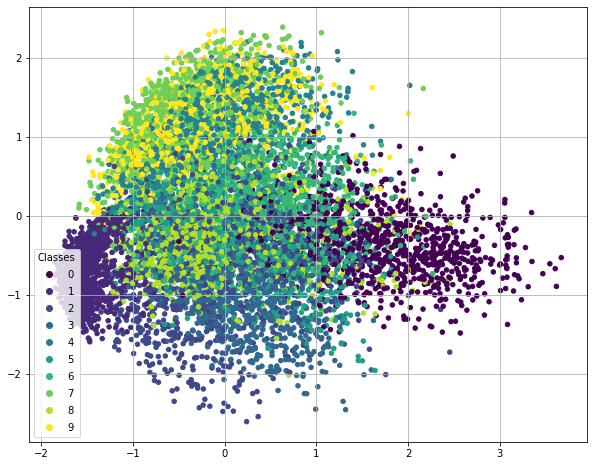

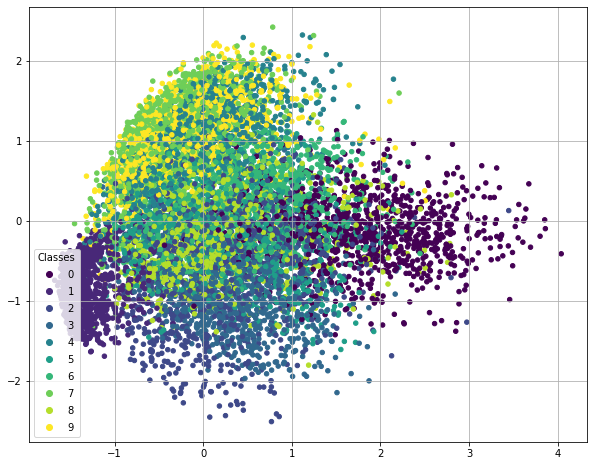

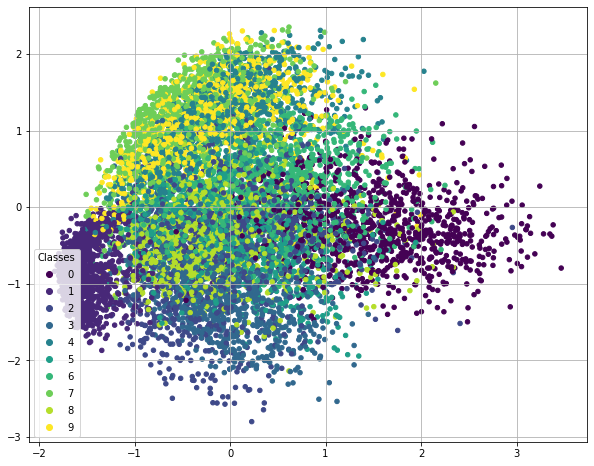

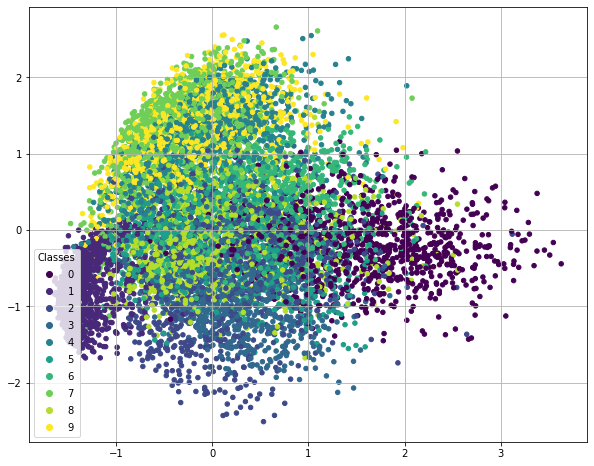

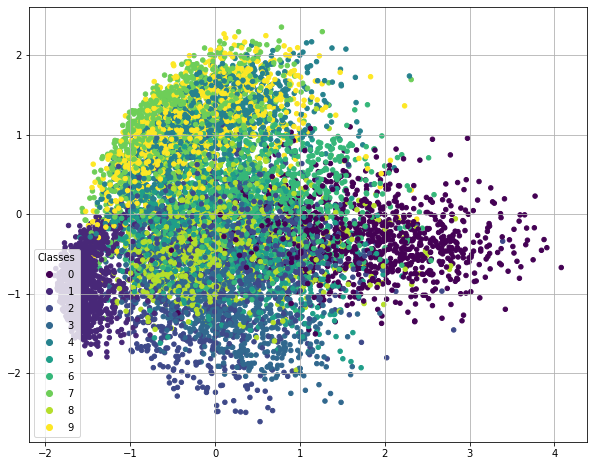

...

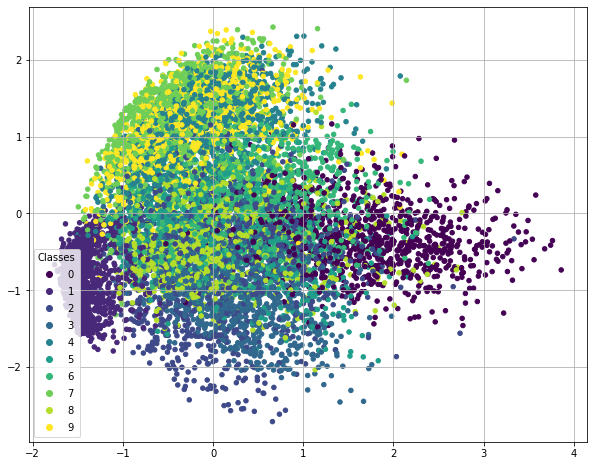

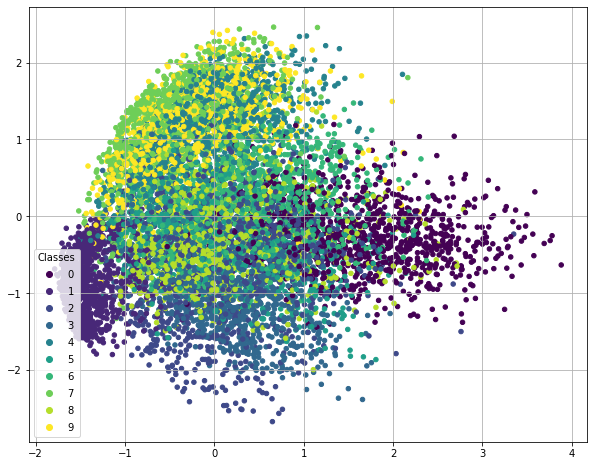

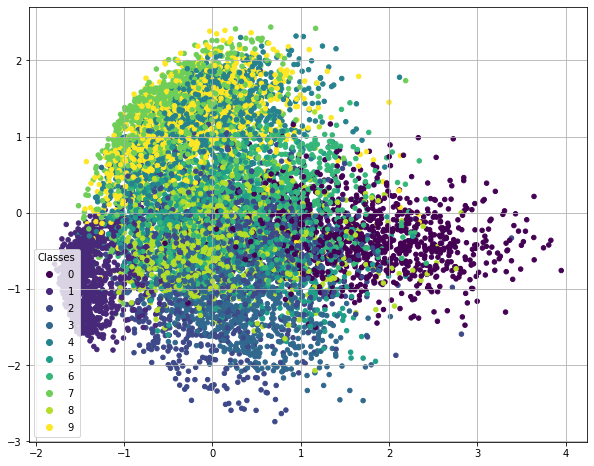

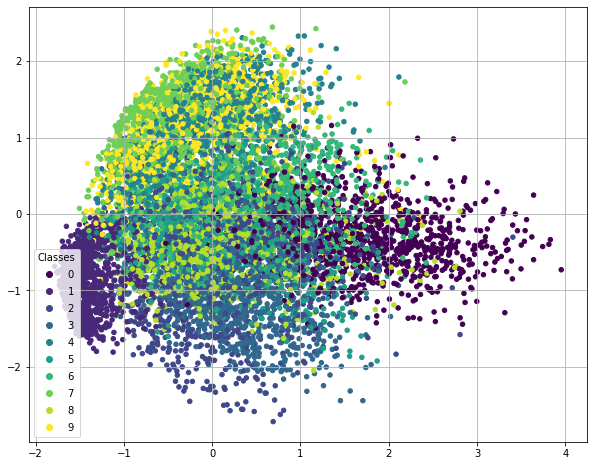

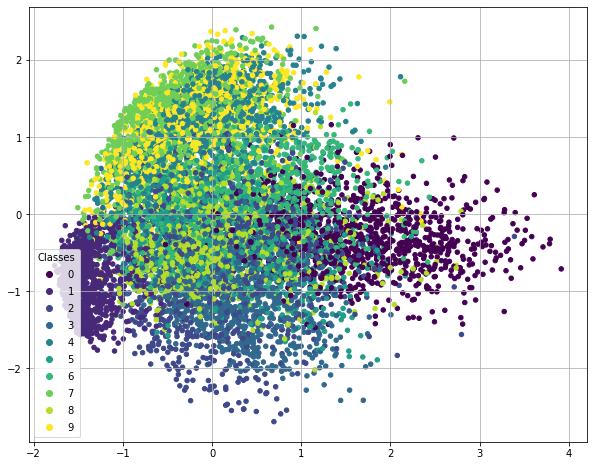

In [9]:
main()

In [13]:
!zip -r vae_pytorch.zip logs/ results/ *.jpg

  adding: logs/ (stored 0%)
  adding: logs/Epoch_Loss_test/ (stored 0%)
  adding: logs/Epoch_Loss_test/events.out.tfevents.1583006207.02980a516a31.1271.2 (deflated 60%)
  adding: logs/events.out.tfevents.1583006187.02980a516a31.1271.0 (deflated 4%)
  adding: logs/Epoch_Loss_train/ (stored 0%)
  adding: logs/Epoch_Loss_train/events.out.tfevents.1583006207.02980a516a31.1271.1 (deflated 61%)
  adding: results/ (stored 0%)
  adding: results/reconstruction_17.png (deflated 1%)
  adding: results/reconstruction_25.png (deflated 1%)
  adding: results/reconstruction_42.png (deflated 1%)
  adding: results/reconstruction_33.png (deflated 1%)
  adding: results/reconstruction_41.png (deflated 1%)
  adding: results/reconstruction_44.png (deflated 1%)
  adding: results/reconstruction_34.png (deflated 1%)
  adding: results/reconstruction_35.png (deflated 1%)
  adding: results/reconstruction_28.png (deflated 1%)
  adding: results/reconstruction_27.png (deflated 1%)
  adding: results/reconstruction_2.pn

In [15]:
!zip -r vae.zip logs/ results/ *.jpg

  adding: logs/ (stored 0%)
  adding: logs/Epoch_Loss_test/ (stored 0%)
  adding: logs/Epoch_Loss_test/events.out.tfevents.1583006207.02980a516a31.1271.2 (deflated 60%)
  adding: logs/events.out.tfevents.1583006187.02980a516a31.1271.0 (deflated 4%)
  adding: logs/Epoch_Loss_train/ (stored 0%)
  adding: logs/Epoch_Loss_train/events.out.tfevents.1583006207.02980a516a31.1271.1 (deflated 61%)
  adding: results/ (stored 0%)
  adding: results/reconstruction_17.png (deflated 1%)
  adding: results/reconstruction_25.png (deflated 1%)
  adding: results/reconstruction_42.png (deflated 1%)
  adding: results/reconstruction_33.png (deflated 1%)
  adding: results/reconstruction_41.png (deflated 1%)
  adding: results/reconstruction_44.png (deflated 1%)
  adding: results/reconstruction_34.png (deflated 1%)
  adding: results/reconstruction_35.png (deflated 1%)
  adding: results/reconstruction_28.png (deflated 1%)
  adding: results/reconstruction_27.png (deflated 1%)
  adding: results/reconstruction_2.pn